# Library

In [1]:
# Ignore the warnings
import warnings
# warnings.filterwarnings('always')
warnings.filterwarnings('ignore')

# System related and data input controls
import os

# Auto reload of library
%reload_ext autoreload
%autoreload 2

# Python path
import sys
base_folder = 'DataScience'
location_base = os.path.join(os.getcwd().split(base_folder)[0], base_folder)
location_module = [os.path.join(location_base, 'Module')] 
for each in location_module:
    if each not in sys.path:
        sys.path.append(each)

from import_KK import *
DeviceStrategy_CPU()
from data_KK import *
from description_KK import *
from preprocessing_KK import *
from preprocessing_text_KK import * ##
from algorithm_textmining_KK import * ##
from evaluation_KK import *
from visualization_KK import *

FONT_NAME = 'malgun'
plt.rc('font', family=FONT_NAME) 
plt.rcParams['font.family'] = FONT_NAME
mpl.rc('font', family=FONT_NAME)
sns.set(font=FONT_NAME) 
sys_font = font_manager.findSystemFonts()
FONT_PATHS = [path for path in sys_font if 'malgun' in path]
if len(FONT_PATHS) != 0:
    rc('font', family=font_manager.FontProperties(fname=FONT_PATHS[0]).get_name())

JAVA is in the system path?:  False
JAVA is in the system path?:  Adding...
Operation Machine:  x86_64
Operation Platform:  64bit
OS Type:  Linux
OS Version:  5.15.167.4-microsoft-standard-WSL2
Python Version:  3.12.2 | packaged by conda-forge | (main, Feb 16 2024, 20:50:58) [GCC 12.3.0]


[nltk_data] Downloading package stopwords to /home/kk/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package punkt to /home/kk/nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package punkt_tab to /home/kk/nltk_data...
[nltk_data]   Package punkt_tab is already up-to-date!
[nltk_data] Downloading package tagsets_json to /home/kk/nltk_data...
[nltk_data]   Package tagsets_json is already up-to-date!
2025-05-07 22:55:06.932159: I tensorflow/core/util/port.cc:153] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2025-05-07 22:55:07.036834: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:467] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
E0000 00:0

Cuda is Ready?  True

Tensorflow Version:  2.19.0
Keras Version:  3.9.2
Torch Version:  2.7.0+cu126


2025-05-07 22:55:21,048	ERROR services.py:1350 -- Failed to start the dashboard , return code -11
2025-05-07 22:55:21,050	ERROR services.py:1375 -- Error should be written to 'dashboard.log' or 'dashboard.err'. We are printing the last 20 lines for you. See 'https://docs.ray.io/en/master/ray-observability/user-guides/configure-logging.html#logging-directory-structure' to find where the log file is.
2025-05-07 22:55:21,051	ERROR services.py:1419 -- 
The last 20 lines of /tmp/ray/session_2025-05-07_22-55-19_426490_1284/logs/dashboard.log (it contains the error message from the dashboard): 
2025-05-07 22:55:20,080	INFO head.py:215 -- Starting dashboard metrics server on port 44227

2025-05-07 22:55:22,247	INFO worker.py:1786 -- Started a local Ray instance.
[nltk_data] Downloading package stopwords to /home/kk/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package punkt to /home/kk/nltk_data...
[nltk_data]   Package punkt is already up-to-date!

(raylet) The node with node id: 6fd494456526ced40d90be9744fbadf8510080f4ae68f96800a06cb2 and address: 172.28.185.17 and node name: 172.28.185.17 has been marked dead because the detector has missed too many heartbeats from it. This can happen when a 	(1) raylet crashes unexpectedly (OOM, etc.) 
	(2) raylet has lagging heartbeats due to slow network or busy workload.


# Hyperparameters

In [2]:
# 데이터 파리미터
SOURCE_NAME = 'NaverNews_키워드전체카테고리사회.csv'
TARGET = 'Title'
CATEGORY = 'Year'
NGRAM_RANGE = (1,1)
TFIDF_MAXCOL = 10000
TFIDF_DELLOWFREQ = False
KEYBERT_TOPNKWD = 5
NUM_SHOWKEYWORD = 200
WINDOW_SIZE = 1
TOKENIZER = 'KeyBERT'
# 저장
SAVE_LOCAL = True

# Data & Preprocessing

In [ ]:
# # 데이터로딩
# df = get_data_from_path(os.path.join('/mnt/d', 'Research', 'SavedData', 'NaverNewsCSR', 'DataRaw'), 
#                         folder_name=True, concat_axis='row', reset_index=True, date_column=None)
# ## 불필요 변수 삭제
# if 'Folder_Name' in df.columns:
#     df.drop(columns=['Folder_Name', 'Sub_Category', '기관', '제목', '제목_원본', '본문', '기고자', '언론사', '키워드'], inplace=True)
# ## 정리
# df = df.loc[:,['일자', 'Year', 'Month', 'Prep_Title', '특성추출(가중치순 상위 50개)']]
# df.rename(columns={'일자':'Date', 'Prep_Title':'TitlePrep', 
#                    '특성추출(가중치순 상위 50개)':'KeywordRanking'}, inplace=True)
# ## 저장
# df.to_csv(os.path.join('/mnt/d', 'Research', 'SavedData', 'NaverNewsCSR', 'Data', SOURCE_NAME), encoding='utf-8-sig', index=False)

In [3]:
# Preprocessing
## 데이터로딩
df = pd.read_csv(os.path.join('/mnt/d', 'Research', 'SavedData', 'NaverNewsCSR', 'Data', SOURCE_NAME), encoding='utf-8-sig')
## 결측값처리
df = df[~df[TARGET+'Prep'].isnull()]
## 빈도추출
## (1,1)
# word_freq, df_prep = preprocessing_wordfreq(df, colname_target=TARGET+'Prep', colname_category=None, language='kr',
#                                           ngram_range=(1,1),
#                                           tfidf_maxcol=TFIDF_MAXCOL, tfidf_dellowfreq=TFIDF_DELLOWFREQ,
#                                           keybert_topnkwd=KEYBERT_TOPNKWD,
#                                           num_showkeyword=NUM_SHOWKEYWORD, 
#                                           save_local=SAVE_LOCAL)
word_freq_categ, df_prepcateg = preprocessing_wordfreq(df, colname_target=TARGET+'Prep', colname_category=CATEGORY, language='kr',
                                                    ngram_range=(1,1),
                                                    tfidf_maxcol=TFIDF_MAXCOL, tfidf_dellowfreq=TFIDF_DELLOWFREQ,
                                                    keybert_topnkwd=KEYBERT_TOPNKWD,
                                                    num_showkeyword=NUM_SHOWKEYWORD, 
                                                    save_local=SAVE_LOCAL)
# ## (1,2)
# word_freq, df_prep = preprocessing_wordfreq(df, colname_target=TARGET+'Prep', colname_category=None, language='kr',
#                                           ngram_range=(1,2),
#                                           tfidf_maxcol=TFIDF_MAXCOL, tfidf_dellowfreq=TFIDF_DELLOWFREQ,
#                                           keybert_topnkwd=KEYBERT_TOPNKWD,
#                                           num_showkeyword=NUM_SHOWKEYWORD, 
#                                           save_local=SAVE_LOCAL)
# word_freq_categ, df_prepcateg = preprocessing_wordfreq(df, colname_target=TARGET+'Prep', colname_category=CATEGORY, language='kr',
#                                                     ngram_range=(1,2),
#                                                     tfidf_maxcol=TFIDF_MAXCOL, tfidf_dellowfreq=TFIDF_DELLOWFREQ,
#                                                     keybert_topnkwd=KEYBERT_TOPNKWD,
#                                                     num_showkeyword=NUM_SHOWKEYWORD, 
#                                                     save_local=SAVE_LOCAL)

  0%|                                                                                             | 0/5 [00:00<?, ?it/s]

Preprocessing...: TF-IDF 2025-05-06 23:52:11.971299
Preprocessing...: KeyBERT 2025-05-06 23:52:20.169118


 20%|███████████████▊                                                               | 1/5 [1:46:10<7:04:41, 6370.25s/it]

Preprocessing...: TF-IDF 2025-05-07 01:38:22.216750
Preprocessing...: KeyBERT 2025-05-07 01:38:26.641535


 40%|███████████████████████████████▌                                               | 2/5 [3:20:31<4:57:38, 5953.00s/it]

Preprocessing...: TF-IDF 2025-05-07 03:12:43.133654
Preprocessing...: KeyBERT 2025-05-07 03:12:48.256916


 60%|███████████████████████████████████████████████▍                               | 3/5 [4:46:26<3:06:17, 5588.67s/it]

Preprocessing...: TF-IDF 2025-05-07 04:38:38.265741
Preprocessing...: KeyBERT 2025-05-07 04:38:42.656371


 80%|███████████████████████████████████████████████████████████████▏               | 4/5 [6:18:32<1:32:44, 5564.14s/it]

Preprocessing...: TF-IDF 2025-05-07 06:10:44.792989
Preprocessing...: KeyBERT 2025-05-07 06:10:47.927929


100%|█████████████████████████████████████████████████████████████████████████████████| 5/5 [7:44:05<00:00, 5569.11s/it]


Sentence to Keywords...: 2025-05-07 07:36:17.520546


100%|████████████████████████████████████████████████████████████████████████| 912792/912792 [10:10:28<00:00, 24.92it/s]


Saving...: 2025-05-07 18:15:17.253435
Results Concat!: 2025-05-07 18:15:26.283727


,Token by SoyNLP,Token by TF-IDF,Token by KeyBERT
Length,0,50000,739025


,category,category,word,score,category,word,score
0,NaN,2020,코로나19,2671,2020,코로나19,8395
1,NaN,2020,코로나,2441,2020,코로나,6885
2,NaN,2020,확진,1985,2020,확진자,5892
3,NaN,2020,확진자,1952,2020,확진,5634
4,NaN,2020,검찰,1578,2020,속보,3894
5,NaN,2020,속보,1536,2020,윤석열,3599
6,NaN,2020,경찰,1385,2020,검찰,3288
7,NaN,2020,서울,1333,2020,경찰,3260
8,NaN,2020,윤석열,1295,2020,환자,2313
9,NaN,2020,포토,1159,2020,마스크,2285


In [12]:
# 데이터로딩: 원본
df_freq = pd.read_csv(os.path.join('/mnt/d', 'Research', 'SavedData', 'NaverNewsCSR', 'Data', 
                                   'df_prep_'+str(NGRAM_RANGE).replace(' ','')+'.csv'), encoding='utf-8-sig')
df_freq_categ = pd.read_csv(os.path.join('/mnt/d', 'Research', 'SavedData', 'NaverNewsCSR', 'Data', 
                                         'df_prepcateg_'+str(NGRAM_RANGE).replace(' ','')+'.csv'), encoding='utf-8-sig')
wordfreq_location = os.path.join('.', 'Result', 'WordFreq')
word_freq = pd.read_csv(os.path.join(wordfreq_location, 'wf_'+TOKENIZER.lower()+'.csv'), encoding='utf-8-sig')
word_freq_categ = pd.read_csv(os.path.join(wordfreq_location, 'wf_categ_'+TOKENIZER.lower()+'.csv'), encoding='utf-8-sig')

# # 동시발생 단어행렬 추출
# coword_direct, coword_undirect = preprocessing_sent2edgelist(df_prep[TARGET+'Prep'], 
#                                                              window_size=WINDOW_SIZE, save_local=SAVE_LOCAL)
# coword_directcateg, coword_undirectcateg = preprocessing_sent2edgelist_bycateg(df_prep, 
#                                                                                colname_target=TARGET+'Prep', colname_categ=CATEGORY, 
#                                                                                window_size=WINDOW_SIZE, save_local=SAVE_LOCAL)

# Result

,count,mean,std,min,25%,50%,75%,max
Length,"912,792.0000",7.9402,2.0085,1.0000,7.0000,8.0000,9.0000,46.0000


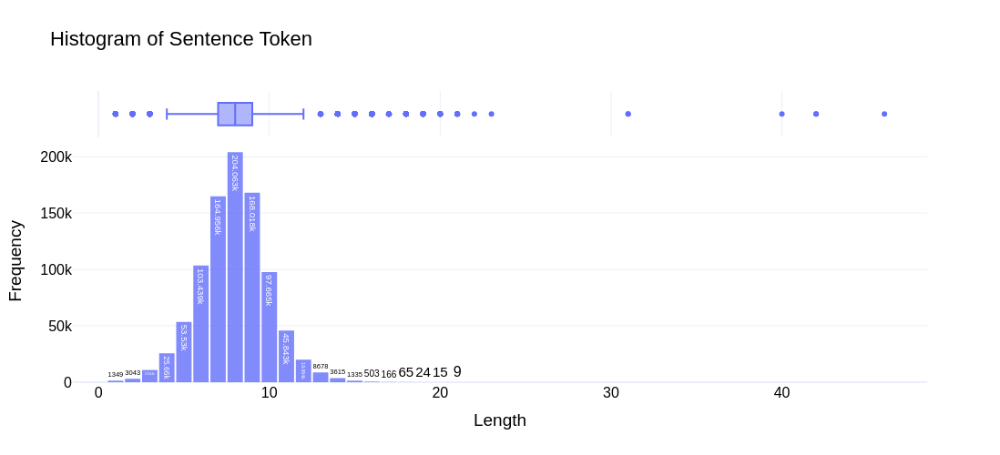

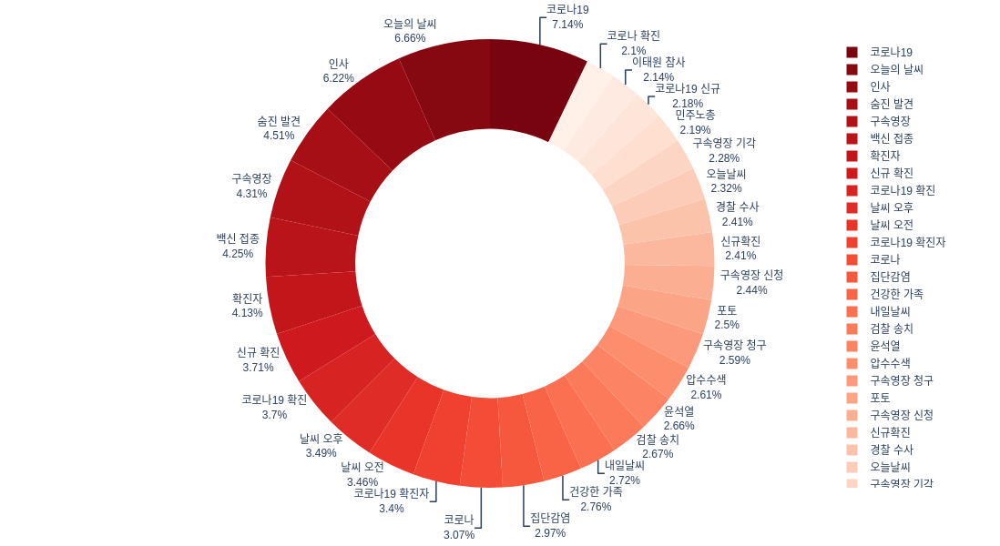

[Kss]: findfont: Font family 'malgun' not found.
[Kss]: findfont: Font family 'malgun' not found.
[Kss]: findfont: Font family 'malgun' not found.
[Kss]: findfont: Font family 'malgun' not found.
[Kss]: findfont: Font family 'malgun' not found.
[Kss]: findfont: Font family 'malgun' not found.
[Kss]: findfont: Font family 'malgun' not found.
[Kss]: findfont: Font family 'malgun' not found.
[Kss]: findfont: Font family 'malgun' not found.
[Kss]: findfont: Font family 'malgun' not found.
[Kss]: findfont: Font family 'malgun' not found.
[Kss]: findfont: Font family 'malgun' not found.
[Kss]: findfont: Font family 'malgun' not found.
[Kss]: findfont: Font family 'malgun' not found.
[Kss]: findfont: Font family 'malgun' not found.
[Kss]: findfont: Font family 'malgun' not found.
[Kss]: findfont: Font family 'malgun' not found.
[Kss]: findfont: Font family 'malgun' not found.
[Kss]: findfont: Font family 'malgun' not found.
[Kss]: findfont: Font family 'malgun' not found.
[Kss]: findfont: Fon

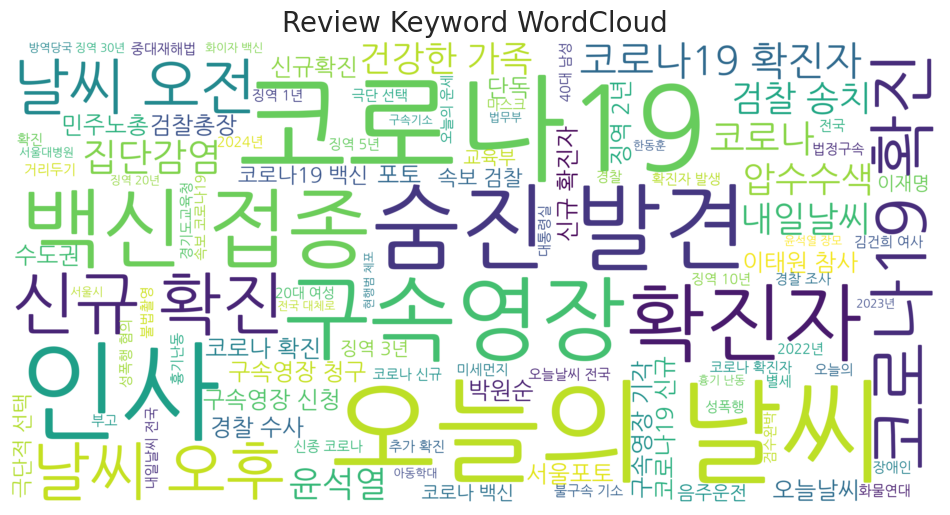

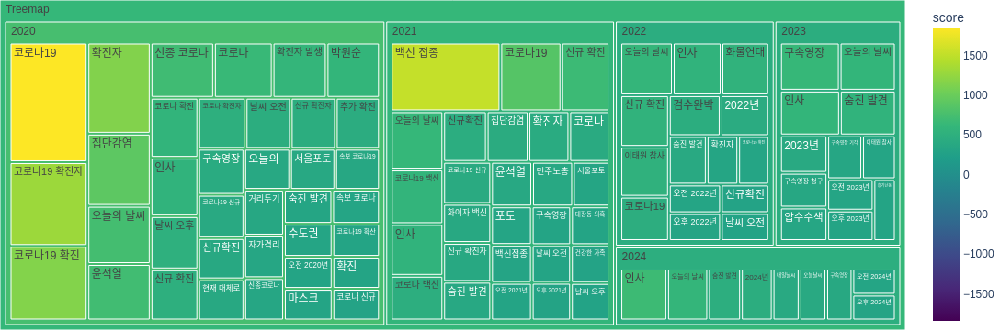

In [13]:
# 키워드 분포
## 리뷰문장 토큰 길이 분포
plot_histogram_senttoken(df['TitlePrep']) 
## 전체기간 주요키워드 분포
plot_donut_wordfreq(word_freq)
plot_wordcloud(word_freq, title='Review Keyword WordCloud', max_font_size=50, save_local=False)
## 연도별(리뷰) 주요키워드 분포
plot_treemap_wordfreq(word_freq_categ)

In [14]:
df_prep.head()

,Date,Year,Month,TitlePrep,KeywordRanking,Token_TF-IDF,Token_KeyBERT
0,2020-01-01,"2,020.0000",2020-01,2020 신년사 도성훈 인천교육감 민주시민 참여 교육공동체 만드는데 중점,"인천,동아시아,교육감,아이들,학생들,도성훈,신년사,인천시민,공동체,경자년,인천교육,정책들,수업료,麗澤相注,대한민국,리스타트,교육청,입학식,독서프로그램,이택상주,시대변화,운영...",2020 참여,2020 신년사 도성훈 인천교육감 민주시민 참여 교육공동체 만드는데 중점
1,2020-01-01,"2,020.0000",2020-01,단독 민주당 사법농단 이탄희 영입 불발 이수정은 고민 중,"변호사,민주당,이수정,장애인,사법농단,법원행정처,판사들,양승태,영입제안,이탄희,행정처,영국,장애인권,사법개혁,검찰개혁,수원지법,곽정숙,방지법,서울신문,서울특별시,대법원장,뒷조사",단독 민주당 사법농단 영입 불발 고민,단독 민주당 사법농단 이탄희 영입 불발 이수정은 고민
2,2020-01-01,"2,020.0000",2020-01,충남도교육청 학부모 교육참여 우수사례 공모전 수상 쾌거,"학부모,공동체,학부모회,공모전,교육부,장려상,이병도,김관태,우수상,최우수상,충남도교육청,동반자,행복학교,반딧불,대산중학교,생태놀,5편,교육혁신과장,전국학부모지원센터,마을공동체성",학부모 우수사례 공모전 수상,충남도교육청 학부모 교육참여 우수사례 공모전 수상 쾌거
3,2020-01-01,"2,020.0000",2020-01,칠곡군 향토생활관 입사생 108명 모집,"입사생,향토생활관,칠곡군,생활관,홈페이지,최인호,다문화,칠곡,대구대,계명대,영남대,대구가톨릭대,경일대,접수기간,수급자,면사무소,차상위계층,총무담당,구비서류,경북대,출신학교,...",모집,칠곡군 향토생활관 입사생 108명 모집
4,2020-01-01,"2,020.0000",2020-01,2020 주요 대학 정시경쟁률 학령인구 감소 까다로운 수능 영향 하락,"전년도,경쟁률,학년도,연세대,고려대,서울대,성균관대,서울,재학생,응시자,경희대,유웨이,지원자,오종운,한양대,서강대,학령인구,주요대,평가이사,가톨릭대,상대적",2020 주요 대학 학령인구 감소 수능 영향 하락,2020 주요 대학 정시경쟁률 학령인구 감소 까다로운 수능 영향 하락
